Analisis de los datasets


In [0]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import requests
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.functions import col, regexp_replace
from pyspark.sql.types import IntegerType

In [0]:
df = spark.read.csv("/FileStore/tables/dataN/NYPD_Arrest_Data__Year_to_Date__20240226.csv", header=True, inferSchema=True)

In [0]:
df3 = spark.read.csv("/FileStore/tables/dataN/Motor_Vehicle_Collisions_Vehicles.csv", header=True, inferSchema=True)

In [0]:
df.printSchema()

root
 |-- ARREST_KEY: integer (nullable = true)
 |-- ARREST_DATE: date (nullable = true)
 |-- PD_CD: integer (nullable = true)
 |-- PD_DESC: string (nullable = true)
 |-- KY_CD: integer (nullable = true)
 |-- OFNS_DESC: string (nullable = true)
 |-- LAW_CODE: string (nullable = true)
 |-- LAW_CAT_CD: string (nullable = true)
 |-- ARREST_BORO: string (nullable = true)
 |-- ARREST_PRECINCT: integer (nullable = true)
 |-- JURISDICTION_CODE: integer (nullable = true)
 |-- AGE_GROUP: string (nullable = true)
 |-- PERP_SEX: string (nullable = true)
 |-- PERP_RACE: string (nullable = true)
 |-- X_COORD_CD: integer (nullable = true)
 |-- Y_COORD_CD: integer (nullable = true)
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)
 |-- New Georeferenced Column: string (nullable = true)



In [0]:
display(df.describe())

summary,ARREST_KEY,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
count,226872,226870,226872,226855,226872,226872,225273,226872,226872,226872,226872,226872,226872,226872,226872,226872,226872,226872
mean,2.706479248400111E8,424.7544011989245,null,249.3451323532653,null,null,9.0,null,63.43052910892486,0.9285367960788462,null,null,null,1005786.7287192778,208289.0843206742,40.738153657440286,-73.92191484770066,null
stddev,5304010.298148575,274.4753806048603,null,147.6867326476054,null,null,0.0,null,34.63504525700398,7.538568508006553,null,null,null,21509.43764815172,29744.71887264725,0.11823655424556538,0.17333780170454133,null
min,261180920,1,(null),101,(null),(null),(null),B,1,0,18-24,F,AMERICAN INDIAN/ALASKAN NATIVE,0,0,0.0,-74.253256,POINT (-73.70059684703173 40.7390218775969)
max,279779734,997,"WEAPONS,MFR,TRANSPORT,ETC.",995,VEHICLE AND TRAFFIC LAWS,VTL21300A5,V,S,123,97,<18,U,WHITE HISPANIC,1067220,271819,40.912714,0.0,POINT (0 0)


In [0]:
df3.select("CONTRIBUTING_FACTOR_1").head(10)

Out[8]: [Row(CONTRIBUTING_FACTOR_1='Unspecified'),
 Row(CONTRIBUTING_FACTOR_1='Driver Inattention/Distraction'),
 Row(CONTRIBUTING_FACTOR_1='Driver Inattention/Distraction'),
 Row(CONTRIBUTING_FACTOR_1='Unspecified'),
 Row(CONTRIBUTING_FACTOR_1='Other Vehicular'),
 Row(CONTRIBUTING_FACTOR_1='Driver Inattention/Distraction'),
 Row(CONTRIBUTING_FACTOR_1='Unspecified'),
 Row(CONTRIBUTING_FACTOR_1='Driver Inattention/Distraction'),
 Row(CONTRIBUTING_FACTOR_1='Unspecified'),
 Row(CONTRIBUTING_FACTOR_1='Driver Inattention/Distraction')]

In [0]:
df3.printSchema()

root
 |-- UNIQUE_ID: integer (nullable = true)
 |-- COLLISION_ID: integer (nullable = true)
 |-- CRASH_DATE: date (nullable = true)
 |-- CRASH_TIME: timestamp (nullable = true)
 |-- VEHICLE_ID: string (nullable = true)
 |-- STATE_REGISTRATION: string (nullable = true)
 |-- VEHICLE_TYPE: string (nullable = true)
 |-- VEHICLE_MAKE: string (nullable = true)
 |-- VEHICLE_MODEL: string (nullable = true)
 |-- VEHICLE_YEAR: integer (nullable = true)
 |-- TRAVEL_DIRECTION: string (nullable = true)
 |-- VEHICLE_OCCUPANTS: integer (nullable = true)
 |-- DRIVER_SEX: string (nullable = true)
 |-- DRIVER_LICENSE_STATUS: string (nullable = true)
 |-- DRIVER_LICENSE_JURISDICTION: string (nullable = true)
 |-- PRE_CRASH: string (nullable = true)
 |-- POINT_OF_IMPACT: string (nullable = true)
 |-- VEHICLE_DAMAGE: string (nullable = true)
 |-- VEHICLE_DAMAGE_1: string (nullable = true)
 |-- VEHICLE_DAMAGE_2: string (nullable = true)
 |-- VEHICLE_DAMAGE_3: string (nullable = true)
 |-- PUBLIC_PROPERTY_DA

In [0]:
df.head()

Out[10]: Row(ARREST_KEY=261265483, ARREST_DATE=datetime.date(2023, 1, 3), PD_CD=397, PD_DESC='ROBBERY,OPEN AREA UNCLASSIFIED', KY_CD=105, OFNS_DESC='ROBBERY', LAW_CODE='PL 1600500', LAW_CAT_CD='F', ARREST_BORO='B', ARREST_PRECINCT=49, JURISDICTION_CODE=0, AGE_GROUP='18-24', PERP_SEX='M', PERP_RACE='BLACK', X_COORD_CD=1027430, Y_COORD_CD=251104, Latitude=40.855793, Longitude=-73.843908, New Georeferenced Column='POINT (-73.843908 40.855793)')

Analisis exploratorio de datos

In [0]:
display(df.describe())

summary,ARREST_KEY,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
count,226872,226870,226872,226855,226872,226872,225273,226872,226872,226872,226872,226872,226872,226872,226872,226872,226872,226872
mean,2.706479248400111E8,424.7544011989245,null,249.3451323532653,null,null,9.0,null,63.43052910892486,0.9285367960788462,null,null,null,1005786.7287192778,208289.0843206742,40.738153657440286,-73.92191484770066,null
stddev,5304010.298148575,274.4753806048603,null,147.6867326476054,null,null,0.0,null,34.63504525700398,7.538568508006553,null,null,null,21509.43764815172,29744.71887264725,0.11823655424556538,0.17333780170454133,null
min,261180920,1,(null),101,(null),(null),(null),B,1,0,18-24,F,AMERICAN INDIAN/ALASKAN NATIVE,0,0,0.0,-74.253256,POINT (-73.70059684703173 40.7390218775969)
max,279779734,997,"WEAPONS,MFR,TRANSPORT,ETC.",995,VEHICLE AND TRAFFIC LAWS,VTL21300A5,V,S,123,97,<18,U,WHITE HISPANIC,1067220,271819,40.912714,0.0,POINT (0 0)


In [0]:
display(df.select(["AGE_GROUP", "PERP_SEX", "PERP_RACE"]).describe())

summary,AGE_GROUP,PERP_SEX,PERP_RACE
count,226872,226872,226872
mean,null,null,null
stddev,null,null,null
min,18-24,F,AMERICAN INDIAN/ALASKAN NATIVE
max,<18,U,WHITE HISPANIC


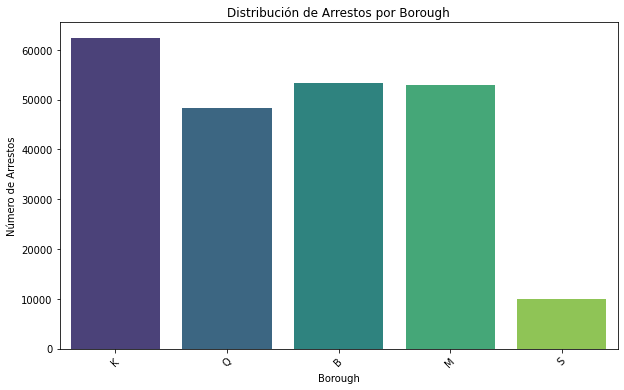

In [0]:

import matplotlib.pyplot as plt
import seaborn as sns


arrests_by_boro = df.groupBy("ARREST_BORO").count().toPandas()
plt.figure(figsize=(10, 6))
sns.barplot(x='ARREST_BORO', y='count', data=arrests_by_boro, palette='viridis')
plt.title('Distribución de Arrestos por Borough')
plt.xlabel('Borough')
plt.ylabel('Número de Arrestos')
plt.xticks(rotation=45)
display()  


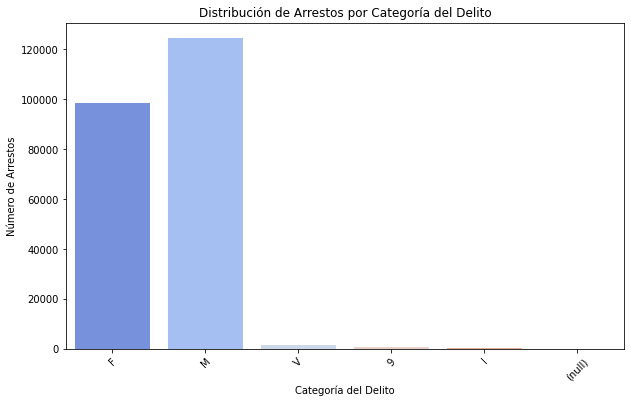

In [0]:

arrests_by_law_cat = df.groupBy("LAW_CAT_CD").count().toPandas()
plt.figure(figsize=(10, 6))
sns.barplot(x='LAW_CAT_CD', y='count', data=arrests_by_law_cat, palette='coolwarm')
plt.title('Distribución de Arrestos por Categoría del Delito')
plt.xlabel('Categoría del Delito')
plt.ylabel('Número de Arrestos')
plt.xticks(rotation=45)
display()  

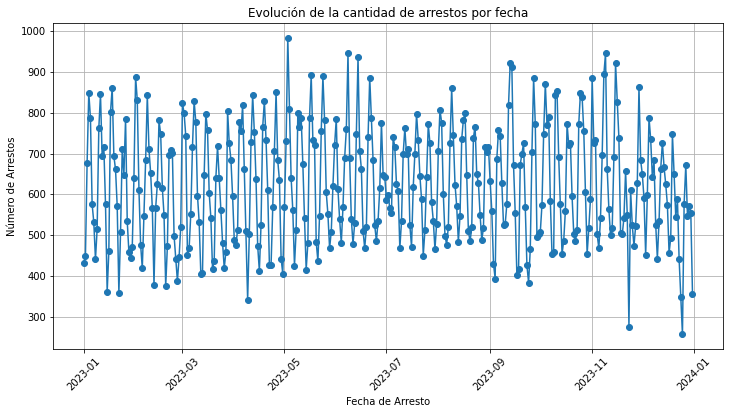

In [0]:
arrests_by_date = df.groupBy("ARREST_DATE").count().orderBy("ARREST_DATE")
arrests_by_date_pd = arrests_by_date.toPandas()
plt.figure(figsize=(12, 6))
plt.plot(arrests_by_date_pd["ARREST_DATE"], arrests_by_date_pd["count"], marker='o', linestyle='-')
plt.title('Evolución de la cantidad de arrestos por fecha')
plt.xlabel('Fecha de Arresto')
plt.ylabel('Número de Arrestos')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

<Figure size 720x576 with 0 Axes>

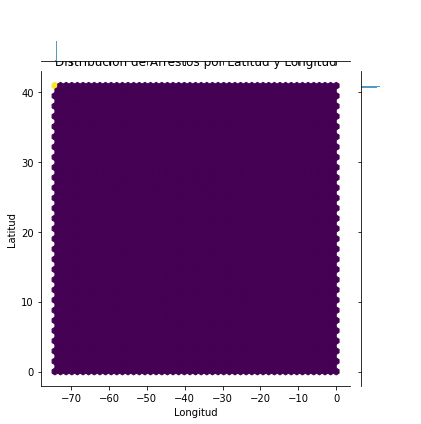

In [0]:

plt.figure(figsize=(10, 8))
sns.jointplot(x='Longitude', y='Latitude', data=df.toPandas(), kind='hex', cmap='viridis')
plt.title('Distribución de Arrestos por Latitud y Longitud')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.show()




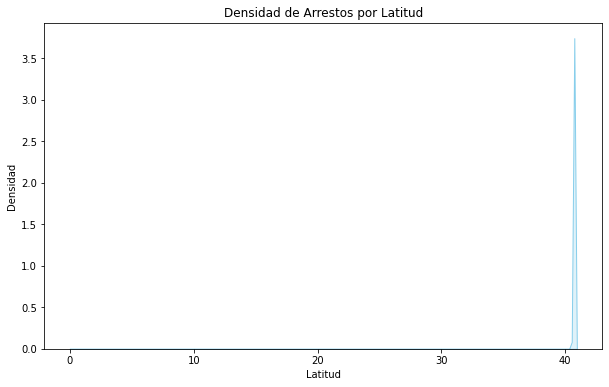

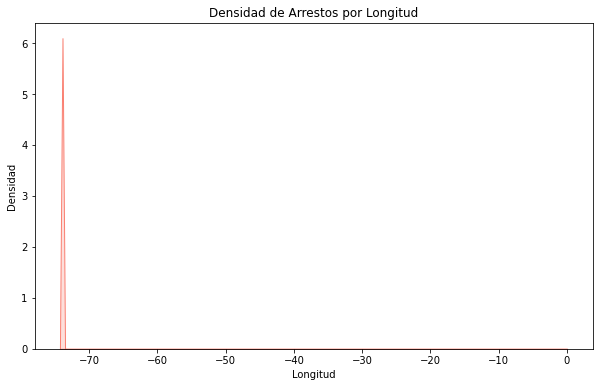

In [0]:
plt.figure(figsize=(10, 6))
sns.kdeplot(df.select("Latitude").toPandas()["Latitude"], shade=True, color="skyblue")
plt.title('Densidad de Arrestos por Latitud')
plt.xlabel('Latitud')
plt.ylabel('Densidad')
plt.show()
plt.figure(figsize=(10, 6))
sns.kdeplot(df.select("Longitude").toPandas()["Longitude"], shade=True, color="salmon")
plt.title('Densidad de Arrestos por Longitud')
plt.xlabel('Longitud')
plt.ylabel('Densidad')
plt.show()


In [0]:
%pip install folium


Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
df

Out[7]: DataFrame[ARREST_KEY: int, ARREST_DATE: date, PD_CD: int, PD_DESC: string, KY_CD: int, OFNS_DESC: string, LAW_CODE: string, LAW_CAT_CD: string, ARREST_BORO: string, ARREST_PRECINCT: int, JURISDICTION_CODE: int, AGE_GROUP: string, PERP_SEX: string, PERP_RACE: string, X_COORD_CD: int, Y_COORD_CD: int, Latitude: double, Longitude: double, New Georeferenced Column: string]

In [0]:
import folium
from folium.plugins import HeatMap
map_heat = folium.Map(location=[40.7128, -74.0060], zoom_start=10)
sample_data = df.sample(fraction=0.1, seed=42).toPandas()
heat_data = [(row['Latitude'], row['Longitude']) for index, row in sample_data.iterrows()]
HeatMap(heat_data).add_to(map_heat)
map_heat



Make this Notebook Trusted to load map: File -> Trust Notebook <iframe srcdoc="<!DOCTYPE html>
<html>
<head>
 
 <meta http-equiv="content-type" content="text/html; charset=UTF-8" />
 
 <script>
 L_NO_TOUCH = false;
 L_DISABLE_3D = false;
 </script>
 
 <style>html, body {width: 100%;height: 100%;margin: 0;padding: 0;}</style>
 <style>#map {position:absolute;top:0;bottom:0;right:0;left:0;}</style>
 <script src="https://cdn.jsdelivr.net/npm/leaflet@1.9.3/dist/leaflet.js"></script>
 <script src="https://code.jquery.com/jquery-3.7.1.min.js"></script>
 <script src="https://cdn.jsdelivr.net/npm/bootstrap@5.2.2/dist/js/bootstrap.bundle.min.js"></script>
 <script src="https://cdnjs.cloudflare.com/ajax/libs/Leaflet.awesome-markers/2.0.2/leaflet.awesome-markers.js"></script>
 <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/leaflet@1.9.3/dist/leaflet.css"/>
 <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.2.2/dist/css/bootstrap.min.css"/>
 <link rel="stylesheet" href="https://netdna.bootstrapcdn.com/bootstrap/3.0.0/css/bootstrap.min.css"/>
 <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/@fortawesome/fontawesome-free@6.2.0/css/all.min.css"/>
 <link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/Leaflet.awesome-markers/2.0.2/leaflet.awesome-markers.css"/>
 <link rel="stylesheet" href="https://cdn.jsdelivr.net/gh/python-visualization/folium/folium/templates/leaflet.awesome.rotate.min.css"/>
 
 <meta name="viewport" content="width=device-width,
 initial-scale=1.0, maximum-scale=1.0, user-scalable=no" />
 <style>
 #map_7f32689245e1fea27cbca6a6acfb4016 {
 position: relative;
 width: 100.0%;
 height: 100.0%;
 left: 0.0%;
 top: 0.0%;
 }
 .leaflet-container { font-size: 1rem; }
 </style>
 
 <script src="https://cdn.jsdelivr.net/gh/python-visualization/folium@main/folium/templates/leaflet_heat.min.js"></script>
</head>
<body>
 
 
 <div class="folium-map" id="map_7f32689245e1fea27cbca6a6acfb4016" ></div>
 
</body>
<script>
 
 
 var map_7f32689245e1fea27cbca6a6acfb4016 = L.map(
 "map_7f32689245e1fea27cbca6a6acfb4016",
 {
 center: [40.7128, -74.006],
 crs: L.CRS.EPSG3857,
 zoom: 10,
 zoomControl: true,
 preferCanvas: false,
 }
 );

 

 
 
 var tile_layer_b86066028f845f854f981528dbfdb587 = L.tileLayer(
 "https://tile.openstreetmap.org/{z}/{x}/{y}.png",
 {"attribution": "\u0026copy; \u003ca href=\"https://www.openstreetmap.org/copyright\"\u003eOpenStreetMap\u003c/a\u003e contributors", "detectRetina": false, "maxNativeZoom": 19, "maxZoom": 19, "minZoom": 0, "noWrap": false, "opacity": 1, "subdomains": "abc", "tms": false}
 );
 
 
 tile_layer_b86066028f845f854f981528dbfdb587.addTo(map_7f32689245e1fea27cbca6a6acfb4016);
 
 
 var heat_map_c98363910439f97802c7922659be6fd6 = L.heatLayer(
 [[40.714082, -73.955662], [40.769552, -73.915361], [40.8694704770483, -73.8798608037303], [40.6744956865259, -73.9305713255961], [40.8084177460021, -73.9524740603515], [40.648698, -73.905128], [40.65236915, -73.88229012], [40.72457498, -73.98749182], [40.766896, -73.96373], [40.798962, -73.941373], [40.769552, -73.915361], [40.511577, -74.249302], [40.822355, -73.911463], [40.8264277, -73.95045075], [40.70195836, -73.92388719], [40.622582, -73.925312], [40.650298, -73.959342], [40.733278, -73.998771], [40.706897, -73.740267], [40.70474877, -73.76347174], [40.744981, -73.870144], [40.667653, -73.870458], [40.750423, -73.98928], [40.680001, -73.752339], [40.688587, -73.748053], [40.706283, -73.950348], [40.547831, -74.13951458], [40.662969, -73.93451], [40.659112692479056, -73.89921817587808], [40.832767, -73.894096], [40.80709737, -73.94597872], [40.87124988, -73.85661415], [40.574091, -74.106113], [40.757691, -73.834115], [40.823378, -73.870168], [40.82018895, -73.89067524], [40.842714, -73.838342], [40.853578, -73.900591], [40.63479932, -74.13555302], [40.72880716553963, -73.8403273829808], [40.86431, -73.86059], [40.677597, -73.828216], [40.883111, -73.90332], [40.628147, -74.008236], [40.742954, -73.955274], [40.6

In [0]:
from pyspark.sql import functions as F
column_name = 'VEHICLE_OCCUPANTS'

quartiles = df3.approxQuantile(column_name, [0.25, 0.75], 0.05)
Q1 = quartiles[0]
Q3 = quartiles[1]
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
outliers = df3.filter((df3[column_name] < lower_bound) | (df3[column_name] > upper_bound))
num_outliers = outliers.count()
print(f"Número de valores atípicos en la columna {column_name}: {num_outliers}")


Número de valores atípicos en la columna VEHICLE_OCCUPANTS: 875632


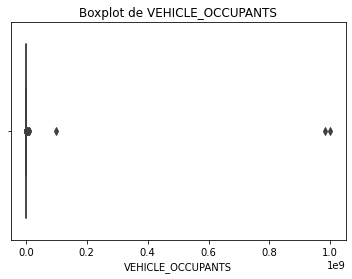

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
df_pandas = df3.toPandas()
sns.boxplot(x=df_pandas['VEHICLE_OCCUPANTS'])
plt.title('Boxplot de VEHICLE_OCCUPANTS')
plt.xlabel('VEHICLE_OCCUPANTS')
plt.show()


In [0]:
display(df3.select('VEHICLE_OCCUPANTS'))


VEHICLE_OCCUPANTS
null
1
null
null
null
2
13
2
null
null


In [0]:

unique_ofns_desc = df.select("LAW_CAT_CD").distinct()
unique_ofns_desc.show(truncate=False)

+----------+
|LAW_CAT_CD|
+----------+
|F         |
|null      |
|M         |
|V         |
|9         |
|I         |
|(null)    |
+----------+



In [0]:
from pyspark.sql.functions import col
missing_values = df.select([col(c).isNull().alias(c) for c in df.columns]).toPandas().sum()
print("Valores faltantes por columna:")
print(missing_values)



Valores faltantes por columna:
ARREST_KEY                     0
ARREST_DATE                    0
PD_CD                          2
PD_DESC                        0
KY_CD                         17
OFNS_DESC                      0
LAW_CODE                       0
LAW_CAT_CD                  1599
ARREST_BORO                    0
ARREST_PRECINCT                0
JURISDICTION_CODE              0
AGE_GROUP                      0
PERP_SEX                       0
PERP_RACE                      0
X_COORD_CD                     0
Y_COORD_CD                     0
Latitude                       0
Longitude                      0
New Georeferenced Column       0
dtype: int64


In [0]:
total_rows = df.count()
print("Cantidad total de datos en el DataFrame:", total_rows)


Cantidad total de datos en el DataFrame: 226872


In [0]:
unique_ofns_desc = df.select("OFNS_DESC").distinct()
unique_ofns_desc.show(truncate=False)


+------------------------------+
|OFNS_DESC                     |
+------------------------------+
|OTHER OFFENSES RELATED TO THEF|
|VEHICLE AND TRAFFIC LAWS      |
|FELONY ASSAULT                |
|THEFT-FRAUD                   |
|MURDER & NON-NEGL. MANSLAUGHTE|
|JOSTLING                      |
|MISCELLANEOUS PENAL LAW       |
|ARSON                         |
|SEX CRIMES                    |
|CRIMINAL TRESPASS             |
|OFFENSES INVOLVING FRAUD      |
|ASSAULT 3 & RELATED OFFENSES  |
|FRAUDS                        |
|DANGEROUS DRUGS               |
|FORGERY                       |
|ROBBERY                       |
|DANGEROUS WEAPONS             |
|PETIT LARCENY                 |
|RAPE                          |
|KIDNAPPING                    |
+------------------------------+
only showing top 20 rows



In [0]:
from pyspark.sql.functions import col
missing_values = df3.select([col(c).isNull().alias(c) for c in df3.columns]).toPandas().sum()
print("Valores faltantes por columna:")
print(missing_values)

Valores faltantes por columna:
UNIQUE_ID                            0
COLLISION_ID                         0
CRASH_DATE                           0
CRASH_TIME                           0
VEHICLE_ID                           0
STATE_REGISTRATION              299164
VEHICLE_TYPE                    232911
VEHICLE_MAKE                   1874569
VEHICLE_MODEL                  4098613
VEHICLE_YEAR                   1893963
TRAVEL_DIRECTION               1665649
VEHICLE_OCCUPANTS              1778286
DRIVER_SEX                     2209212
DRIVER_LICENSE_STATUS          2296864
DRIVER_LICENSE_JURISDICTION    2291944
PRE_CRASH                       918633
POINT_OF_IMPACT                1698458
VEHICLE_DAMAGE                 1722396
VEHICLE_DAMAGE_1               2587669
VEHICLE_DAMAGE_2               2974293
VEHICLE_DAMAGE_3               3249573
PUBLIC_PROPERTY_DAMAGE         1528858
PUBLIC_PROPERTY_DAMAGE_TYPE    4124336
CONTRIBUTING_FACTOR_1           146119
CONTRIBUTING_FACTOR_2          16

Tratamiento de valores faltantes

In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col, lit, when

df = df.na.replace("(null)", None)



columns_to_drop = ['LAW_CAT_CD', 'PD_CD', 'KY_CD', 'PD_DESC']
df = df.drop(*columns_to_drop)

borough_mapping = {'B': 'Bronx', 'K': 'Brooklyn', 'M': 'Manhattan', 'Q': 'Queens', 'S': 'Staten Island'}
for abbrev, name in borough_mapping.items():
    df = df.withColumn("ARREST_BORO", when(col("ARREST_BORO") == abbrev, name).otherwise(col("ARREST_BORO")))


jurisdiction_mapping = {0: 'Patrol', 1: 'Transit', 2: 'Housing'}
for code, name in jurisdiction_mapping.items():
    df = df.withColumn("JURISDICTION_CODE", when(col("JURISDICTION_CODE") == code, name).otherwise(col("JURISDICTION_CODE")))


other_codes = [71, 69, 72, 11, 87, 14, 15, 7, 3, 4, 97, 73, 88, 85, 13, 6, 17, 79, 52, 74, 51, 12]
for code in other_codes:
    df = df.withColumn("JURISDICTION_CODE", when(col("JURISDICTION_CODE") == code, lit('Other')).otherwise(col("JURISDICTION_CODE")))


df = df.dropna()

In [0]:
total_rows = df3.count()
print("Cantidad total de datos en el DataFrame:", total_rows)

Cantidad total de datos en el DataFrame: 4150041


In [0]:
from pyspark.sql.functions import  count
null_counts_per_column = df3.agg(*[(1 - (count(c) / count("*"))).alias(c+"_nulls") for c in df3.columns])
column_with_most_nulls = max(null_counts_per_column.columns, key=lambda x: null_counts_per_column.select(x).first()[0])
print("La columna con más valores nulos en df3 es:", column_with_most_nulls)
print("Cantidad de valores nulos:", null_counts_per_column.select(column_with_most_nulls).first()[0])



La columna con más valores nulos en df3 es: PUBLIC_PROPERTY_DAMAGE_TYPE_nulls
Cantidad de valores nulos: 0.9938060852892778


In [0]:
unique_ofns_desc = df3.select("CONTRIBUTING_FACTOR_1").distinct()
unique_ofns_desc.show(truncate=False)

+------------------------------+
|CONTRIBUTING_FACTOR_1         |
+------------------------------+
|Following Too Closely         |
|Traffic Control Disregarded   |
|Passing or Lane Usage Improper|
|null                          |
|Other Vehicular               |
|Driver Inexperience           |
|Unspecified                   |
|Prescription Medication       |
|Lost Consciousness            |
|Outside Car Distraction       |
|Fatigued/Drowsy               |
|Driver Inattention/Distraction|
|Unsafe Lane Changing          |
|Passenger Distraction         |
|Alcohol Involvement           |
|Illness                       |
|Backing Unsafely              |
|Failure to Yield Right-of-Way |
|Turning Improperly            |
|Passing Too Closely           |
+------------------------------+
only showing top 20 rows



In [0]:
print(df3['VEHICLE_OCCUPANTS'])

Column<'VEHICLE_OCCUPANTS'>


In [0]:
from pyspark.sql import functions as F
min_value = df3.select(F.min('VEHICLE_OCCUPANTS')).collect()[0][0]
max_value = df3.select(F.max('VEHICLE_OCCUPANTS')).collect()[0][0]
display(min_value)
display(max_value)


0999999999

In [0]:
from pyspark.sql import functions as F
max_value = df3.select(F.max('VEHICLE_OCCUPANTS')).first()[0]
rows_with_max_value = df3.filter(df3['VEHICLE_OCCUPANTS'] == max_value)
display(rows_with_max_value)


UNIQUE_ID,COLLISION_ID,CRASH_DATE,CRASH_TIME,VEHICLE_ID,STATE_REGISTRATION,VEHICLE_TYPE,VEHICLE_MAKE,VEHICLE_MODEL,VEHICLE_YEAR,TRAVEL_DIRECTION,VEHICLE_OCCUPANTS,DRIVER_SEX,DRIVER_LICENSE_STATUS,DRIVER_LICENSE_JURISDICTION,PRE_CRASH,POINT_OF_IMPACT,VEHICLE_DAMAGE,VEHICLE_DAMAGE_1,VEHICLE_DAMAGE_2,VEHICLE_DAMAGE_3,PUBLIC_PROPERTY_DAMAGE,PUBLIC_PROPERTY_DAMAGE_TYPE,CONTRIBUTING_FACTOR_1,CONTRIBUTING_FACTOR_2
17914214,3760446,2017-09-29,2024-06-02T16:06:00.000+0000,49905ee7-bac5-4435-aeb3-bb05b9f2551f,null,null,null,null,null,East,999999999,null,null,null,null,null,null,null,null,null,N,null,null,null


In [0]:
from pyspark.sql.functions import col, median
median_value = df3.stat.approxQuantile("VEHICLE_OCCUPANTS", [0.5], 0)[0]
df3 = df3.na.fill({"VEHICLE_OCCUPANTS": median_value})
df3.show()






+---------+------------+----------+-------------------+--------------------+------------------+--------------------+--------------+-------------+------------+----------------+-----------------+----------+---------------------+---------------------------+--------------------+--------------------+--------------------+--------------------+------------------+----------------+----------------------+---------------------------+---------------------+---------------------+
|UNIQUE_ID|COLLISION_ID|CRASH_DATE|         CRASH_TIME|          VEHICLE_ID|STATE_REGISTRATION|        VEHICLE_TYPE|  VEHICLE_MAKE|VEHICLE_MODEL|VEHICLE_YEAR|TRAVEL_DIRECTION|VEHICLE_OCCUPANTS|DRIVER_SEX|DRIVER_LICENSE_STATUS|DRIVER_LICENSE_JURISDICTION|           PRE_CRASH|     POINT_OF_IMPACT|      VEHICLE_DAMAGE|    VEHICLE_DAMAGE_1|  VEHICLE_DAMAGE_2|VEHICLE_DAMAGE_3|PUBLIC_PROPERTY_DAMAGE|PUBLIC_PROPERTY_DAMAGE_TYPE|CONTRIBUTING_FACTOR_1|CONTRIBUTING_FACTOR_2|
+---------+------------+----------+-------------------+-----

In [0]:
print(median_value)

1.0


In [0]:
unique_ofns_desc = df3.select("VEHICLE_OCCUPANTS").distinct()
unique_ofns_desc.show(truncate=False)

+-----------------+
|VEHICLE_OCCUPANTS|
+-----------------+
|26               |
|1                |
|13               |
|6                |
|3                |
|54               |
|650              |
|5                |
|9                |
|4                |
|8                |
|7                |
|10               |
|24               |
|62               |
|33               |
|11               |
|14               |
|2                |
|0                |
+-----------------+
only showing top 20 rows



In [0]:

missing_values = df3.select([col(c).isNull().alias(c) for c in df3.columns]).toPandas().sum()

print("Valores faltantes por columna:")
print(missing_values)

Valores faltantes por columna:
UNIQUE_ID                            0
COLLISION_ID                         0
CRASH_DATE                           0
CRASH_TIME                           0
VEHICLE_ID                           0
STATE_REGISTRATION              299164
VEHICLE_TYPE                    232911
VEHICLE_MAKE                   1874569
VEHICLE_MODEL                  4098613
VEHICLE_YEAR                   1893963
TRAVEL_DIRECTION               1665649
VEHICLE_OCCUPANTS                    0
DRIVER_SEX                     2209212
DRIVER_LICENSE_STATUS          2296864
DRIVER_LICENSE_JURISDICTION    2291944
PRE_CRASH                       918633
POINT_OF_IMPACT                1698458
VEHICLE_DAMAGE                 1722396
VEHICLE_DAMAGE_1               2587669
VEHICLE_DAMAGE_2               2974293
VEHICLE_DAMAGE_3               3249573
PUBLIC_PROPERTY_DAMAGE         1528858
PUBLIC_PROPERTY_DAMAGE_TYPE    4124336
CONTRIBUTING_FACTOR_1           146119
CONTRIBUTING_FACTOR_2          16

In [0]:
from pyspark.sql.functions import lit
from pyspark.sql import Window
mode_value_df = df3.groupBy("CONTRIBUTING_FACTOR_1").count()
windowSpec = Window.orderBy(F.desc("count"))
mode_value = mode_value_df.withColumn("rank", F.rank().over(windowSpec)) \
                          .filter(col("rank") == 1) \
                          .select("CONTRIBUTING_FACTOR_1") \
                          .collect()[0]["CONTRIBUTING_FACTOR_1"]

df3 = df3.na.fill({"CONTRIBUTING_FACTOR_1": mode_value})
df3.show()


+---------+------------+----------+-------------------+--------------------+------------------+--------------------+--------------+-------------+------------+----------------+-----------------+----------+---------------------+---------------------------+--------------------+--------------------+--------------------+--------------------+------------------+----------------+----------------------+---------------------------+---------------------+---------------------+
|UNIQUE_ID|COLLISION_ID|CRASH_DATE|         CRASH_TIME|          VEHICLE_ID|STATE_REGISTRATION|        VEHICLE_TYPE|  VEHICLE_MAKE|VEHICLE_MODEL|VEHICLE_YEAR|TRAVEL_DIRECTION|VEHICLE_OCCUPANTS|DRIVER_SEX|DRIVER_LICENSE_STATUS|DRIVER_LICENSE_JURISDICTION|           PRE_CRASH|     POINT_OF_IMPACT|      VEHICLE_DAMAGE|    VEHICLE_DAMAGE_1|  VEHICLE_DAMAGE_2|VEHICLE_DAMAGE_3|PUBLIC_PROPERTY_DAMAGE|PUBLIC_PROPERTY_DAMAGE_TYPE|CONTRIBUTING_FACTOR_1|CONTRIBUTING_FACTOR_2|
+---------+------------+----------+-------------------+-----

###Parte II

In [0]:
from pyspark.sql.functions import col, to_date, hour, dayofweek, avg, count
# Convertir las columnas de fecha al mismo formato
df = df.withColumn("ARREST_DATE", to_date(col("ARREST_DATE"), "yyyy-MM-dd"))
df3 = df3.withColumn("CRASH_DATE", to_date(col("CRASH_DATE"), "yyyy-MM-dd"))

In [0]:
display(df)

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
261265483,2023-01-03,397,"ROBBERY,OPEN AREA UNCLASSIFIED",105,ROBBERY,PL 1600500,F,B,49,0,18-24,M,BLACK,1027430,251104,40.855793,-73.843908,POINT (-73.843908 40.855793)
261271301,2023-01-03,105,STRANGULATION 1ST,106,FELONY ASSAULT,PL 1211200,F,S,120,0,25-44,M,WHITE,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)
261336449,2023-01-04,397,"ROBBERY,OPEN AREA UNCLASSIFIED",105,ROBBERY,PL 1601001,F,K,61,0,<18,M,BLACK,995118,155708,40.594054,-73.960866,POINT (-73.960866 40.594054)
261328047,2023-01-04,105,STRANGULATION 1ST,106,FELONY ASSAULT,PL 1211200,F,Q,114,0,18-24,M,BLACK,1007694,219656,40.769552,-73.915361,POINT (-73.915361 40.769552)
261417496,2023-01-05,244,"BURGLARY,UNCLASSIFIED,UNKNOWN",107,BURGLARY,PL 1402000,F,B,44,0,25-44,F,BLACK,1007174,239542,40.824135,-73.91717,POINT (-73.91717 40.824135)
261583093,2023-01-08,109,"ASSAULT 2,1,UNCLASSIFIED",106,FELONY ASSAULT,PL 1200502,F,K,76,0,25-44,M,BLACK,984110,188363,40.683691,-74.000504,POINT (-74.000504 40.683691)
261611504,2023-01-09,263,"ARSON 2,3,4",114,ARSON,PL 1501500,F,B,49,71,25-44,M,WHITE,1028555,246897,40.84424,-73.839868,POINT (-73.839868 40.84424)
261892107,2023-01-14,109,"ASSAULT 2,1,UNCLASSIFIED",106,FELONY ASSAULT,PL 1200501,F,K,90,0,25-44,M,BLACK,996541,199439,40.714082,-73.955662,POINT (-73.955662 40.714082)
261926460,2023-01-14,263,"ARSON 2,3,4",114,ARSON,PL 1501001,F,K,63,0,25-44,M,BLACK,1000520,168264,40.628508,-73.941384,POINT (-73.941384 40.628508)
262973934,2023-02-03,105,STRANGULATION 1ST,106,FELONY ASSAULT,PL 1211200,F,M,34,0,25-44,M,BLACK,1003818,253167,40.861538,-73.929256,POINT (-73.929256 40.861538)


###Respuesta a las preguntas

In [0]:

population_data = [
    ("BRONX", "B", 1472654),
    ("BROOKLYN", "K", 2736074),
    ("MANHATTAN", "M", 1694251),
    ("QUEENS", "Q", 2405464),
    ("STATEN ISLAND", "S", 495747)
]

columns = ["BORO_NM", "ARREST_BORO", "POPULATION"]
population_df = spark.createDataFrame(data=population_data, schema=columns)

arrests_by_boro = df.groupBy("ARREST_BORO").count()

arrests_with_population = arrests_by_boro.join(population_df, "ARREST_BORO")
arrests_with_population = arrests_with_population.withColumn("RATE_PER_10K", (col("count") / col("POPULATION")) * 10000)

arrests_with_population.select("BORO_NM", "RATE_PER_10K").show()


+-------------+------------------+
|      BORO_NM|      RATE_PER_10K|
+-------------+------------------+
|        BRONX| 361.6463880857282|
|     BROOKLYN|228.04573268120674|
|    MANHATTAN| 312.1792461683658|
|       QUEENS|200.83443360615667|
|STATEN ISLAND| 202.0788829786161|
+-------------+------------------+



In [0]:

df_collisions = df3.select("CONTRIBUTING_FACTOR_1", "VEHICLE_TYPE")

df_collisions = df_collisions.filter(col("CONTRIBUTING_FACTOR_1").isNotNull() & col("VEHICLE_TYPE").isNotNull())


In [0]:
df_collisions_filtered = df_collisions.filter(
    (col("CONTRIBUTING_FACTOR_1") != "Unspecified") &
    (col("CONTRIBUTING_FACTOR_1") != "UNKNOWN") &
    (col("VEHICLE_TYPE") != "Unspecified") &
    (col("VEHICLE_TYPE") != "UNKNOWN")
)

In [0]:

factor_vehicle_type_counts_filtered = df_collisions_filtered.groupBy("CONTRIBUTING_FACTOR_1", "VEHICLE_TYPE").agg(count("*").alias("COUNT"))

factor_vehicle_type_counts_filtered.orderBy("COUNT", ascending=False).show()



+---------------------+--------------------+------+
|CONTRIBUTING_FACTOR_1|        VEHICLE_TYPE| COUNT|
+---------------------+--------------------+------+
| Driver Inattentio...|               Sedan|147957|
| Driver Inattentio...|Station Wagon/Spo...|118122|
| Driver Inattentio...|   PASSENGER VEHICLE| 59360|
| Following Too Clo...|               Sedan| 53580|
| Following Too Clo...|Station Wagon/Spo...| 44515|
| Failure to Yield ...|               Sedan| 42624|
| Failure to Yield ...|Station Wagon/Spo...| 34681|
|      Fatigued/Drowsy|   PASSENGER VEHICLE| 29446|
| Driver Inattentio...|SPORT UTILITY / S...| 28018|
|      Other Vehicular|               Sedan| 23435|
| Passing or Lane U...|               Sedan| 23254|
| Failure to Yield ...|   PASSENGER VEHICLE| 21814|
|     Backing Unsafely|Station Wagon/Spo...| 21253|
|      Other Vehicular|   PASSENGER VEHICLE| 20213|
| Unsafe Lane Changing|               Sedan| 19376|
| Passing or Lane U...|Station Wagon/Spo...| 18868|
|     Backin

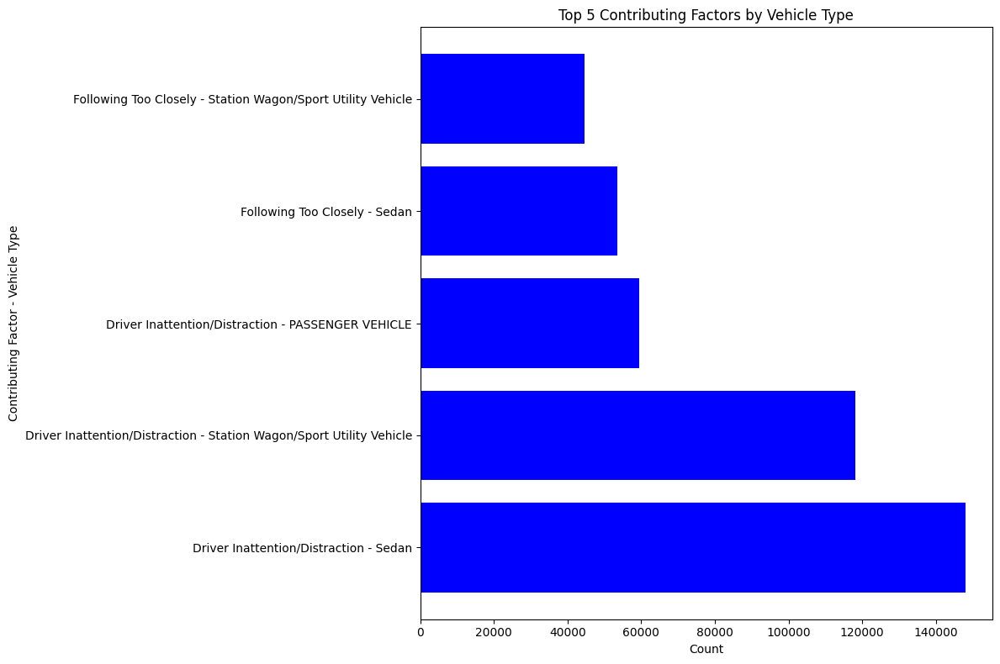

In [0]:

pandas_df = factor_vehicle_type_counts_filtered.orderBy("COUNT", ascending=False).limit(5).toPandas()

plt.figure(figsize=(12, 8))
plt.barh(pandas_df['CONTRIBUTING_FACTOR_1'] + ' - ' + pandas_df['VEHICLE_TYPE'], pandas_df['COUNT'], color='blue')

plt.title('Top 5 Contributing Factors by Vehicle Type')
plt.xlabel('Count')
plt.ylabel('Contributing Factor - Vehicle Type')
plt.tight_layout()

plt.show()

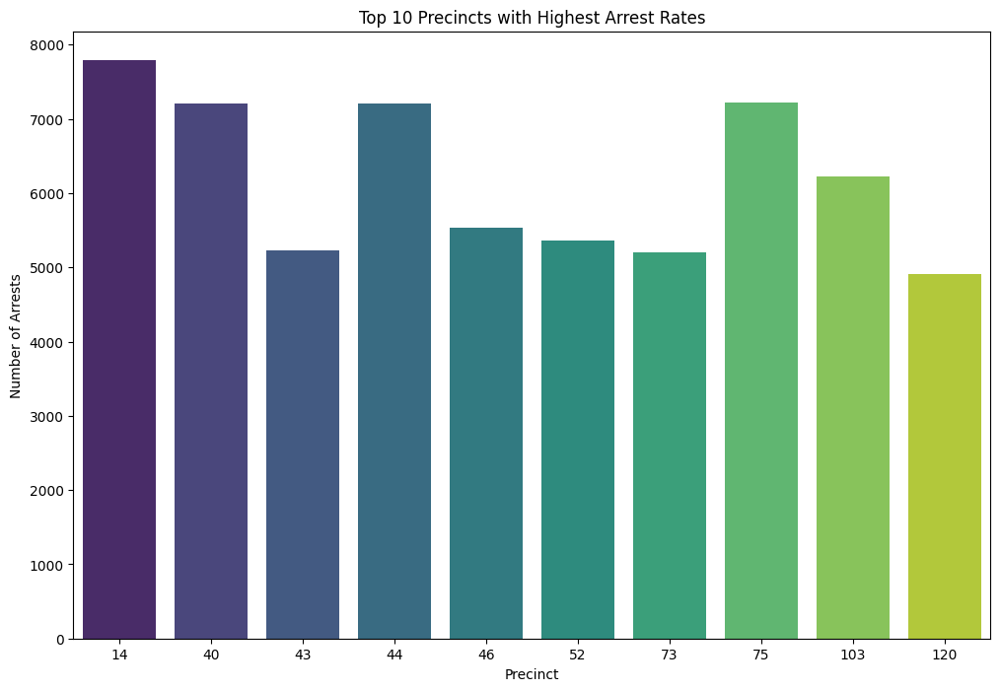

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns


arrest_rates = df.groupBy("ARREST_PRECINCT").agg(count("ARREST_KEY").alias("ARREST_COUNT"))


arrest_rates_pd = arrest_rates.orderBy("ARREST_COUNT", ascending=False).limit(10).toPandas()

plt.figure(figsize=(12, 8))
sns.barplot(y='ARREST_COUNT', x='ARREST_PRECINCT', data=arrest_rates_pd, palette='viridis')
plt.title('Top 10 Precincts with Highest Arrest Rates')
plt.ylabel('Number of Arrests')
plt.xlabel('Precinct')
plt.show()



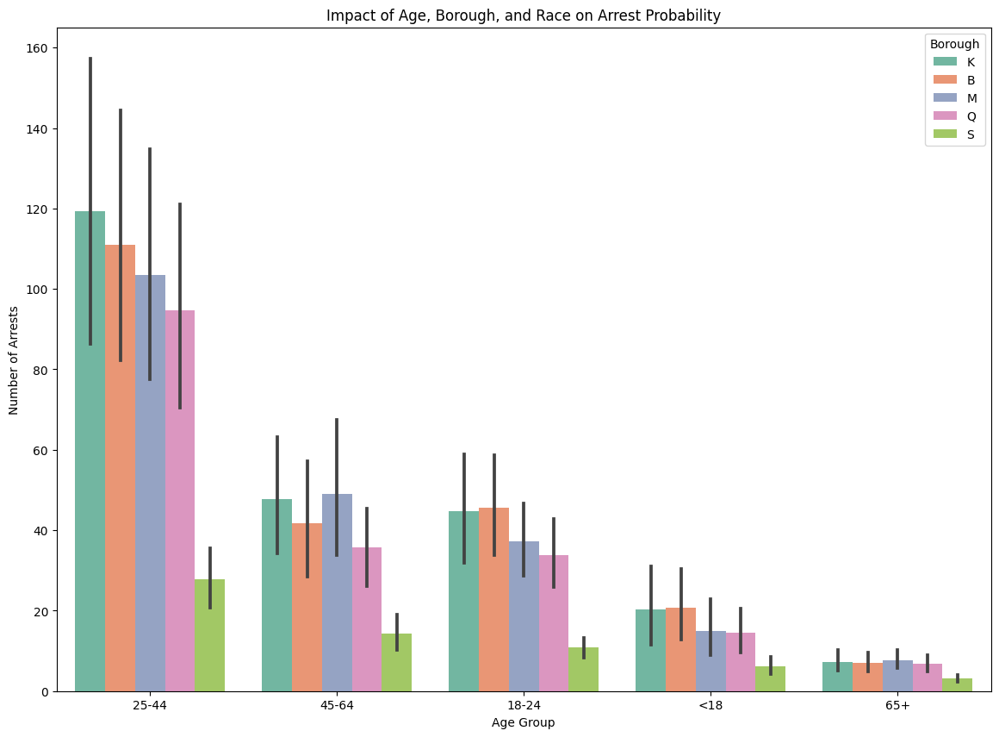

In [0]:

arrest_by_demo = df.groupBy("AGE_GROUP", "ARREST_BORO", "PERP_RACE", "OFNS_DESC").agg(count("ARREST_KEY").alias("ARREST_COUNT"))


arrest_by_demo_pd = arrest_by_demo.orderBy("ARREST_COUNT", ascending=False).toPandas()

arrest_by_demo_sample = arrest_by_demo_pd 


plt.figure(figsize=(14, 10))
sns.barplot(y='ARREST_COUNT', x='AGE_GROUP', hue='ARREST_BORO', data=arrest_by_demo_sample, palette='Set2')
plt.title('Impact of Age, Borough, and Race on Arrest Probability')
plt.ylabel('Number of Arrests')
plt.xlabel('Age Group')
plt.legend(title='Borough')
plt.show()



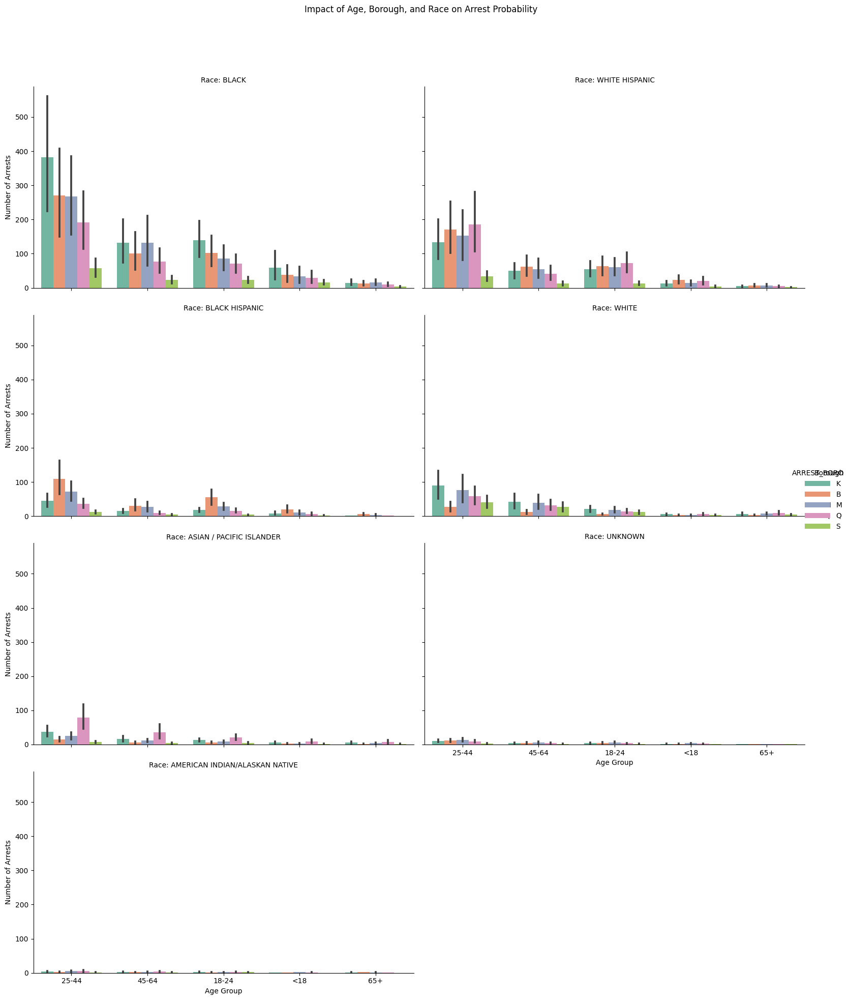

In [0]:

arrest_by_demo_sample = arrest_by_demo_pd 

g = sns.catplot(
    data=arrest_by_demo_sample, kind="bar",
    y="ARREST_COUNT", x="AGE_GROUP", hue="ARREST_BORO",
    col="PERP_RACE", col_wrap=2,
    height=5, aspect=1.5, palette="Set2"
)

g.set_axis_labels("Age Group", "Number of Arrests")
g.set_titles("Race: {col_name}")
g.add_legend(title="Borough")
plt.subplots_adjust(top=0.9)
g.fig.suptitle('Impact of Age, Borough, and Race on Arrest Probability')
plt.show()


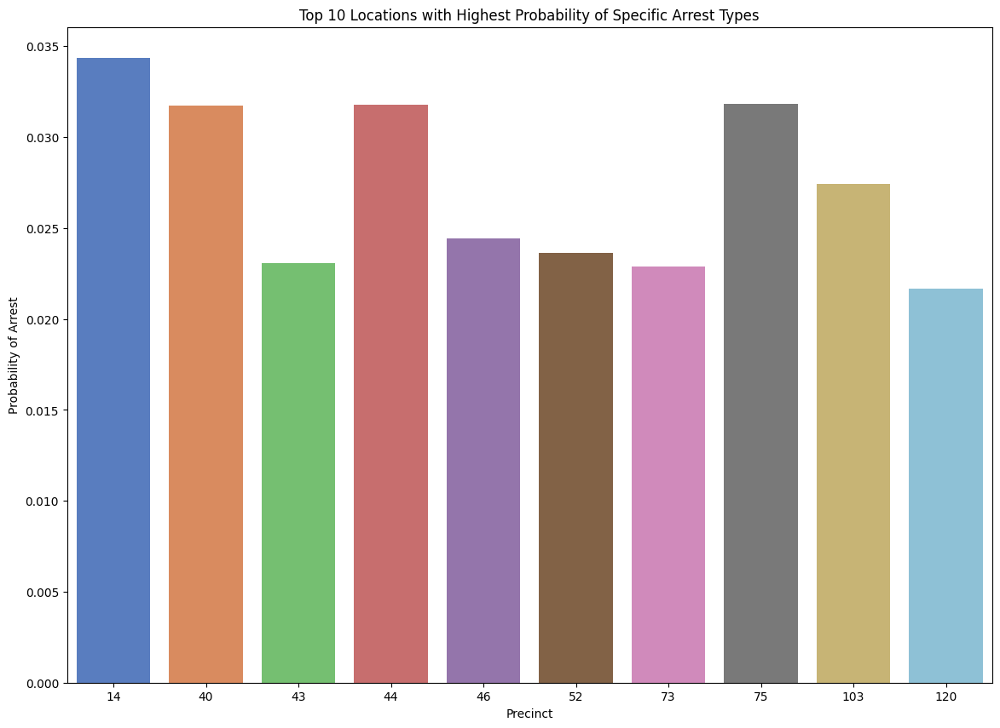

In [0]:
import pyspark.sql.functions as F

total_arrests = df.count()

arrests_by_location = df.groupBy("ARREST_PRECINCT").agg(F.count("ARREST_KEY").alias("ARREST_COUNT"))

arrests_by_location = arrests_by_location.withColumn("ARREST_PROBABILITY", arrests_by_location["ARREST_COUNT"] / total_arrests)

arrests_by_location_pd = arrests_by_location.orderBy("ARREST_PROBABILITY", ascending=False).limit(10).toPandas()

plt.figure(figsize=(14, 10))
sns.barplot(y='ARREST_PROBABILITY', x='ARREST_PRECINCT', data=arrests_by_location_pd, dodge=False, palette='muted')
plt.title('Top 10 Locations with Highest Probability of Specific Arrest Types')
plt.ylabel('Probability of Arrest')
plt.xlabel('Precinct')
plt.show()



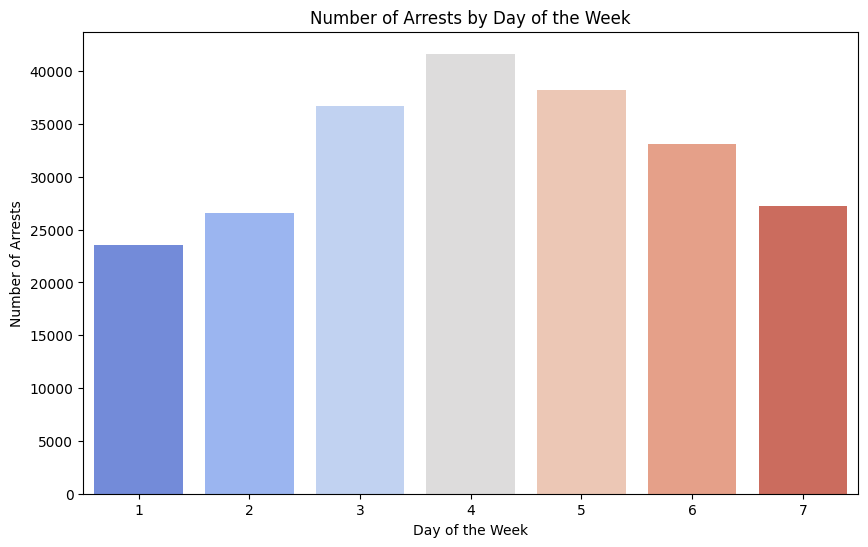

In [0]:
from pyspark.sql.functions import dayofweek

df = df.withColumn("DAY_OF_WEEK", dayofweek(col("ARREST_DATE")))

arrests_by_day = df.groupBy("DAY_OF_WEEK").agg(count("ARREST_KEY").alias("ARREST_COUNT"))

arrests_by_day_pd = arrests_by_day.orderBy("DAY_OF_WEEK").toPandas()

plt.figure(figsize=(10, 6))
sns.barplot(x='DAY_OF_WEEK', y='ARREST_COUNT', data=arrests_by_day_pd, palette='coolwarm')
plt.title('Number of Arrests by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Number of Arrests')
plt.show()


/root/.ipykernel/1022/command-4071739479177411-3082897350:15: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  sns.heatmap(collisions_by_day_hour_pd.pivot("DAY_OF_WEEK", "HOUR_OF_DAY", "COLLISION_COUNT"), cmap='viridis')


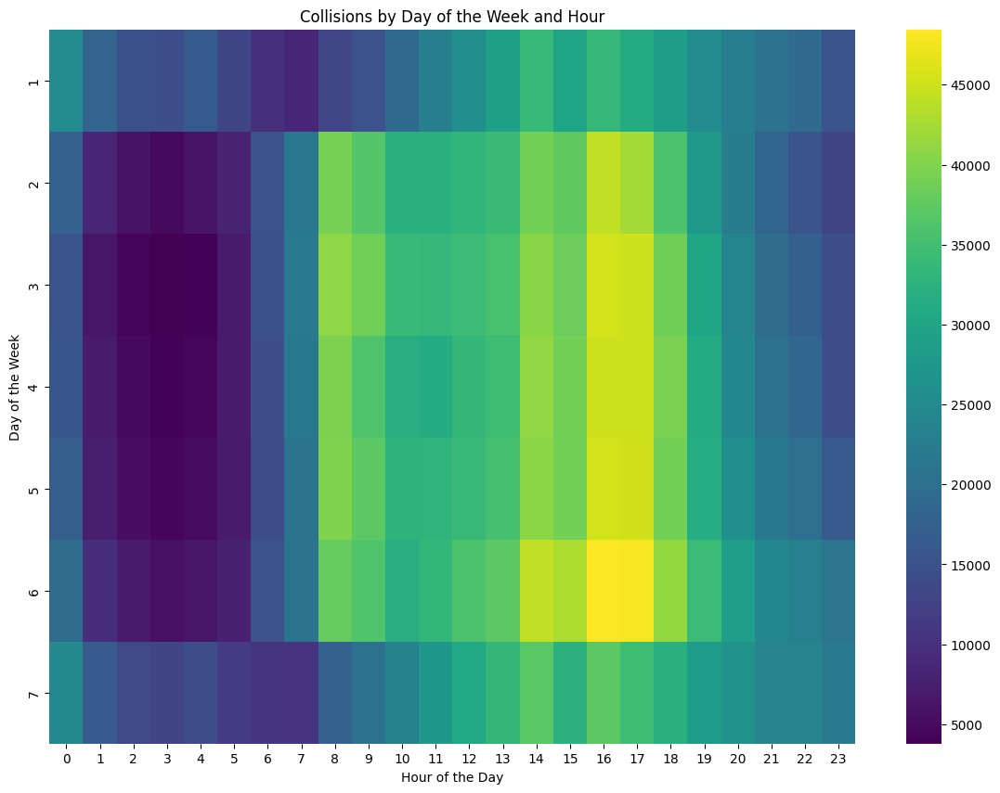

In [0]:
from pyspark.sql.functions import hour

df3 = df3.withColumn("DAY_OF_WEEK", dayofweek(col("CRASH_DATE")))
df3 = df3.withColumn("HOUR_OF_DAY", hour(col("CRASH_TIME")))

collisions_by_day_hour = df3.groupBy("DAY_OF_WEEK", "HOUR_OF_DAY").agg(count("COLLISION_ID").alias("COLLISION_COUNT"))

collisions_by_day_hour_pd = collisions_by_day_hour.orderBy("COLLISION_COUNT", ascending=False).toPandas()

plt.figure(figsize=(14, 10))
sns.heatmap(collisions_by_day_hour_pd.pivot("DAY_OF_WEEK", "HOUR_OF_DAY", "COLLISION_COUNT"), cmap='viridis')
plt.title('Collisions by Day of the Week and Hour')
plt.xlabel('Hour of the Day')
plt.ylabel('Day of the Week')
plt.show()


In [0]:

df3 = df3[df3['VEHICLE_TYPE'] != 'UNKNOWN']

In [0]:
co=df3[df3['VEHICLE_TYPE'] == 'PASSENGER VEHICLE']

In [0]:
display(co)

UNIQUE_ID,COLLISION_ID,CRASH_DATE,CRASH_TIME,VEHICLE_ID,STATE_REGISTRATION,VEHICLE_TYPE,VEHICLE_MAKE,VEHICLE_MODEL,VEHICLE_YEAR,TRAVEL_DIRECTION,VEHICLE_OCCUPANTS,DRIVER_SEX,DRIVER_LICENSE_STATUS,DRIVER_LICENSE_JURISDICTION,PRE_CRASH,POINT_OF_IMPACT,VEHICLE_DAMAGE,VEHICLE_DAMAGE_1,VEHICLE_DAMAGE_2,VEHICLE_DAMAGE_3,PUBLIC_PROPERTY_DAMAGE,PUBLIC_PROPERTY_DAMAGE_TYPE,CONTRIBUTING_FACTOR_1,CONTRIBUTING_FACTOR_2,DAY_OF_WEEK,HOUR_OF_DAY
10385780,100201,2012-09-07,2024-06-02T09:03:00Z,1,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,Unspecified,null,6,9
14889754,3308693,2015-10-04,2024-06-02T20:34:00Z,1,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,Parked,null,null,null,null,null,null,null,Unspecified,null,1,20
14400270,297666,2013-04-25,2024-06-02T21:15:00Z,1,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,Other Vehicular,null,5,21
12254536,196425,2013-07-16,2024-06-02T11:20:00Z,1,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,Unspecified,null,3,11
11804847,2975897,2012-11-26,2024-06-02T18:12:00Z,2,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,Driver Inattention/Distraction,null,2,18
14809587,3268858,2015-08-01,2024-06-02T08:17:00Z,2,NJ,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,Going Straight Ahead,null,null,null,null,null,null,null,Passenger Distraction,null,7,8
9879462,79561,2013-04-09,2024-06-02T15:10:00Z,1,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,Unspecified,null,3,15
9882078,328209,2014-05-01,2024-06-02T21:16:00Z,1,FL,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,Backing,null,null,null,null,null,null,null,Unspecified,null,5,21
14221219,3108421,2014-08-04,2024-06-02T01:10:00Z,2,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,Going Straight Ahead,null,null,null,null,null,null,null,Unspecified,null,2,1
11758197,1014563,2014-08-27,2024-06-02T14:30:00Z,2,NY,PASSENGER VEHICLE,null,null,null,null,null,null,null,null,Going Straight Ahead,null,null,null,null,null,null,null,Unspecified,null,4,14


In [0]:
display(vehicles_collisions)

VEHICLE_TYPE,COLLISION_COUNT,AVERAGE_OCCUPANTS
trail,139,0.753731343283582
School Bus,378,2.931693989071038
TRK,40,1.1
NYC S,2,1.0
Station Wagon/Sport Utility Vehicle,824960,124.72595285117379
4dsd,6,1.0
FREIG,37,1.5675675675675675
Flat Bed,5086,1.0034524776604388
subn,160,1.53125
PC,18,1.2222222222222223


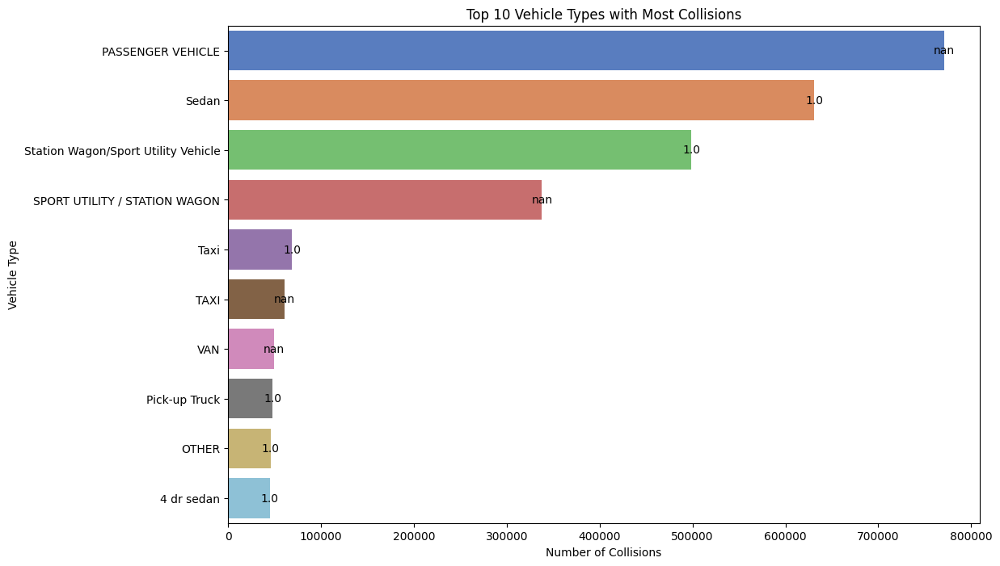

In [0]:
df3_pd = df3.toPandas()
# Identificar y eliminar outliers usando IQR para VEHICLE_OCCUPANTS
Q1 = df3_pd['VEHICLE_OCCUPANTS'].quantile(0.25)
Q3 = df3_pd['VEHICLE_OCCUPANTS'].quantile(0.75)
IQR = Q3 - Q1

# Filtrar outliers
filtered_df3_pd = df3_pd[~((df3_pd['VEHICLE_OCCUPANTS'] < (Q1 - 1.5 * IQR)) | (df3_pd['VEHICLE_OCCUPANTS'] > (Q3 + 1.5 * IQR)))]

# Convertir de nuevo a Spark DataFrame
filtered_df3 = spark.createDataFrame(filtered_df3_pd)

# Agrupar por VEHICLE_TYPE y contar el número de colisiones y calcular el promedio de ocupantes
vehicles_collisions = filtered_df3.groupBy("VEHICLE_TYPE").agg(count("COLLISION_ID").alias("COLLISION_COUNT"), avg("VEHICLE_OCCUPANTS").alias("AVERAGE_OCCUPANTS"))

vehicles_collisions_pd = vehicles_collisions.orderBy("COLLISION_COUNT", ascending=False).limit(10).toPandas()


plt.figure(figsize=(12, 8))
barplot = sns.barplot(x='COLLISION_COUNT', y='VEHICLE_TYPE', data=vehicles_collisions_pd, palette='muted')

for index, row in vehicles_collisions_pd.iterrows():
    barplot.text(row['COLLISION_COUNT'], index, round(row['AVERAGE_OCCUPANTS'], 2), color='black', ha="center", va="center")

plt.title('Top 10 Vehicle Types with Most Collisions')
plt.xlabel('Number of Collisions')
plt.ylabel('Vehicle Type')
plt.show()

###K-means proceso

In [0]:
from pyspark.sql.functions import col

# Reemplazar los valores nulos con la media de cada columna numérica
df = df.fillna({
    'ARREST_KEY': df.agg({'ARREST_KEY': 'mean'}).collect()[0][0],
    'PD_CD': df.agg({'PD_CD': 'mean'}).collect()[0][0],
    'KY_CD': df.agg({'KY_CD': 'mean'}).collect()[0][0],
    'ARREST_PRECINCT': df.agg({'ARREST_PRECINCT': 'mean'}).collect()[0][0],
    'JURISDICTION_CODE': df.agg({'JURISDICTION_CODE': 'mean'}).collect()[0][0],
    'X_COORD_CD': df.agg({'X_COORD_CD': 'mean'}).collect()[0][0],
    'Y_COORD_CD': df.agg({'Y_COORD_CD': 'mean'}).collect()[0][0],
    'Latitude': df.agg({'Latitude': 'mean'}).collect()[0][0],
    'Longitude': df.agg({'Longitude': 'mean'}).collect()[0][0],
})

ARREST_KEY,PD_CD,KY_CD,ARREST_PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
261265483,397,105,49,0,1027430,251104,40.855793,-73.843908
261271301,105,106,120,0,962808,174275,40.644996,-74.077263
261336449,397,105,61,0,995118,155708,40.594054,-73.960866
261328047,105,106,114,0,1007694,219656,40.769552,-73.915361
261417496,244,107,44,0,1007174,239542,40.824135,-73.91717
261583093,109,106,76,0,984110,188363,40.683691,-74.000504
261611504,263,114,49,71,1028555,246897,40.84424,-73.839868
261892107,109,106,90,0,996541,199439,40.714082,-73.955662
261926460,263,114,63,0,1000520,168264,40.628508,-73.941384
262973934,105,106,34,0,1003818,253167,40.861538,-73.929256


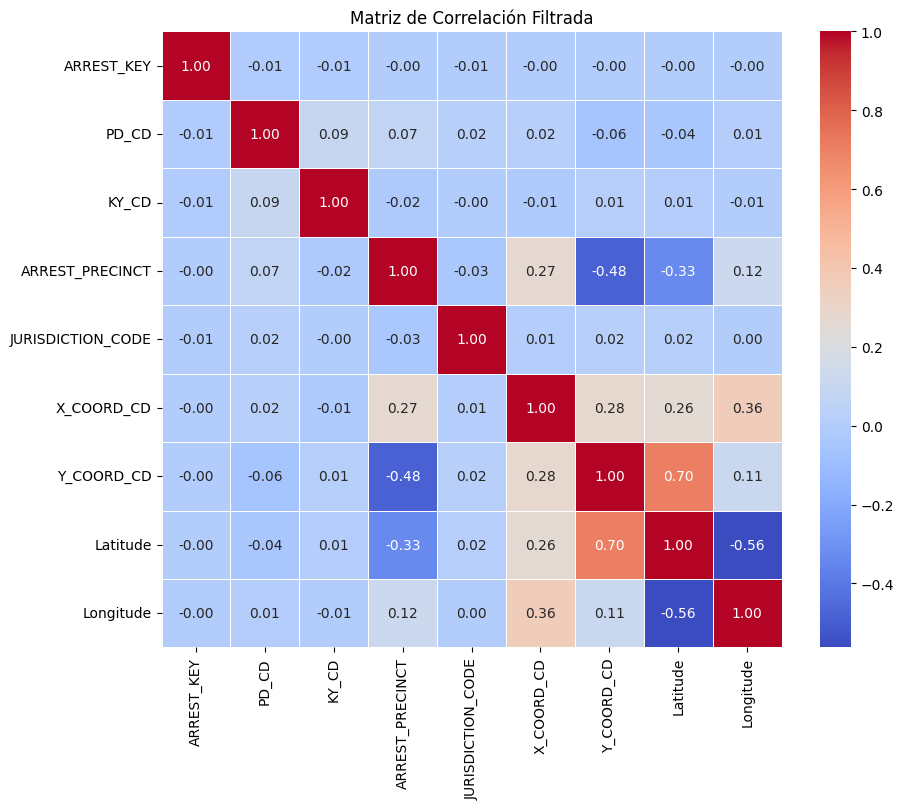

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.stat import Correlation
from pyspark.sql.functions import col

numerical_columns = ["ARREST_KEY", "PD_CD", "KY_CD", "ARREST_PRECINCT", "JURISDICTION_CODE", "X_COORD_CD", "Y_COORD_CD", "Latitude", "Longitude"]
df_numeric = df.select([col(c).cast("double") for c in numerical_columns])

# Ensamblar las columnas numéricas en un vector
vector_col = "corr_features"
assembler = VectorAssembler(inputCols=numerical_columns, outputCol=vector_col)
df_vector = assembler.transform(df_numeric).select(vector_col)

# Calcular la matriz de correlación
matrix = Correlation.corr(df_vector, vector_col)
corr_matrix = matrix.collect()[0][0]

corr_array = np.array(corr_matrix.toArray())

corr_df = pd.DataFrame(corr_array, index=numerical_columns, columns=numerical_columns)

# Identificar columnas para eliminar
correlated_columns = set()
threshold = 0.8
for i in range(len(corr_df.columns)):
    for j in range(i):
        if abs(corr_df.iloc[i, j]) > threshold:
            colname = corr_df.columns[i]
            correlated_columns.add(colname)

# Eliminar las columnas correlacionadas del DataFrame original
columns_to_keep = [col for col in numerical_columns if col not in correlated_columns]
df_filtered = df.select(columns_to_keep)
display(df_filtered)
# Calcular la nueva matriz de correlación para las columnas restantes
df_numeric_filtered = df_filtered.select([col(c).cast("double") for c in columns_to_keep])
assembler = VectorAssembler(inputCols=columns_to_keep, outputCol=vector_col)
df_vector_filtered = assembler.transform(df_numeric_filtered).select(vector_col)
matrix_filtered = Correlation.corr(df_vector_filtered, vector_col)
corr_matrix_filtered = matrix_filtered.collect()[0][0]

# Convertir la matriz de correlación filtrada a un array de numpy
corr_array_filtered = np.array(corr_matrix_filtered.toArray())

corr_df_filtered = pd.DataFrame(corr_array_filtered, index=columns_to_keep, columns=columns_to_keep)


plt.figure(figsize=(10, 8))
sns.heatmap(corr_df_filtered, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)
plt.title('Matriz de Correlación Filtrada')
plt.show()



In [0]:
from pyspark.ml.feature import StandardScaler
numeric_cols = ["ARREST_KEY", "PD_CD", "KY_CD", "ARREST_PRECINCT", "JURISDICTION_CODE", "Latitude", "Longitude"]
assembler = VectorAssembler(inputCols=numeric_cols, outputCol="assembled_features")
df_vector = assembler.transform(df_filtered)
scaler = StandardScaler(inputCol="assembled_features", outputCol="scaled_features", withMean=True, withStd=True)
scaler_model = scaler.fit(df_vector)
df_scaled = scaler_model.transform(df_vector)
df_scaled.select("scaled_features").show(5)

+--------------------+
|     scaled_features|
+--------------------+
|[-1.7689335639650...|
|[-1.7678366581007...|
|[-1.7555538765189...|
|[-1.7571379609244...|
|[-1.7402735517374...|
+--------------------+
only showing top 5 rows



In [0]:
# Seleccionar las variables para K-means
selected_features = ["ARREST_PRECINCT", "KY_CD", "Latitude", "Longitude"]
assembler = VectorAssembler(inputCols=selected_features, outputCol="features")
df_final = assembler.transform(df_scaled)

df_final.select("features").show(5)


+--------------------+
|            features|
+--------------------+
|[49.0,105.0,40.85...|
|[120.0,106.0,40.6...|
|[61.0,105.0,40.59...|
|[114.0,106.0,40.7...|
|[44.0,107.0,40.82...|
+--------------------+
only showing top 5 rows



In [0]:
from pyspark.ml.evaluation import ClusteringEvaluator
from pyspark.ml.clustering import KMeans
import pandas as pd

# Definir valores de k y maxIter
k_values = [3, 4, 5, 6]
max_iter_values = [10, 20, 30, 40]

results = []


for k in k_values:
    for max_iter in max_iter_values:
        # Configurar K-means
        kmeans = KMeans(k=k, maxIter=max_iter, seed=1, featuresCol="features", predictionCol="cluster")
        model = kmeans.fit(df_final)
        
        # Realizar predicciones
        df_clusters = model.transform(df_final)
        
        # Evaluar el clustering
        evaluator = ClusteringEvaluator(featuresCol="features", predictionCol="cluster")
        silhouette = evaluator.evaluate(df_clusters)
        

        results.append((k, max_iter, silhouette))


results_df = pd.DataFrame(results, columns=["k", "maxIter", "SilhouetteScore"])
print(results_df)


    k  maxIter  SilhouetteScore
0   3       10         0.861381
1   3       20         0.861381
2   3       30         0.861381
3   3       40         0.861381
4   4       10         0.883089
5   4       20         0.883089
6   4       30         0.883089
7   4       40         0.883089
8   5       10         0.848936
9   5       20         0.848936
10  5       30         0.848936
11  5       40         0.848936
12  6       10         0.816003
13  6       20         0.816003
14  6       30         0.816003
15  6       40         0.816003


/root/.ipykernel/1022/command-4071739479177425-3951301002:5: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  results_pivot = results_df.pivot("k", "maxIter", "SilhouetteScore")


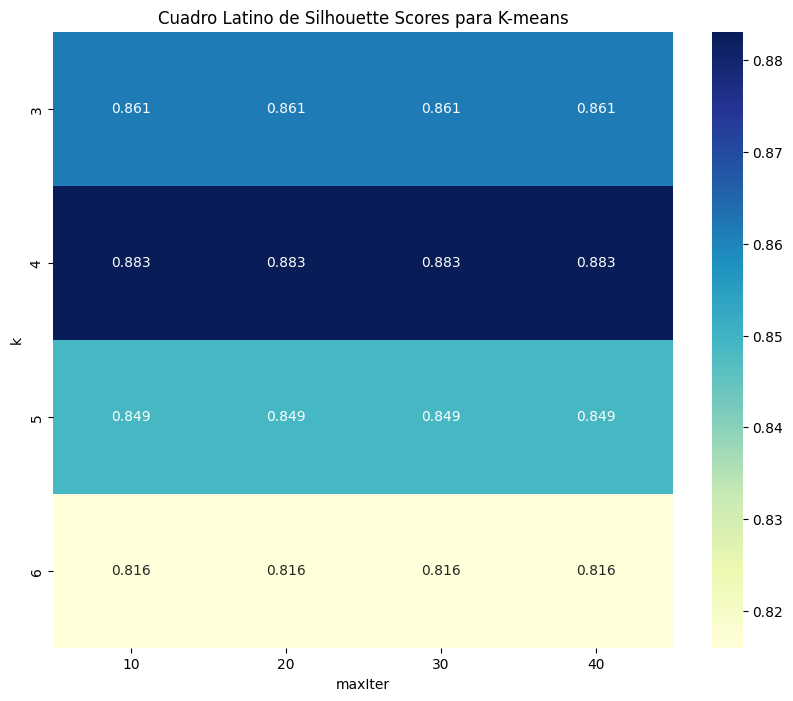

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns


results_pivot = results_df.pivot("k", "maxIter", "SilhouetteScore")

plt.figure(figsize=(10, 8))
sns.heatmap(results_pivot, annot=True, cmap="YlGnBu", cbar=True, fmt=".3f")
plt.title("Cuadro Latino de Silhouette Scores para K-means")
plt.xlabel("maxIter")
plt.ylabel("k")
plt.show()
